## IceNet - Seasonal Arctic sea ice forecasting

IceNet is a probabilistic, deep learning sea ice forecasting system to predict the Arctic sea ice coverage in the upcoming months. The model has been trained on climate simulations and observational data to forecast the next 6 months of monthly-averaged sea ice concentration maps. Sea ice is the frozen seawater that is present in areas near both the North and South poles, and sea ice coverage forecasting is important to both communication and scientific authorities. However, actual forecasting is notoriously difficult because of the complex relationship among the atmosphere, ocean surface, and sea ice, itself. IceNet advances the range of accurate sea ice forecasts, outperforming a state-of-the-art dynamical model in seasonal forecasts of summer sea ice, particularly for extreme sea ice events.

This notebook implements the probabilistic deep learning model described in the paper 'Seasonal Arctic sea ice forecasting with probabilistic deep learning' (https://www.nature.com/articles/s41467-021-25257-4)

<p style="text-align:center;">
    <img src="./assets/icenet_paper.png" width="600" height="700" class="center">
</p>   

## Data Description

The data used in the notebook consists of 11 climatic variables that capture teleconnections between the stratospheric polar vortex and negative anomalies in Arctic sea ice extent. A brief description of the input variables and their sources is presented in the table below: 

<p style="text-align:center;">
    <img src="./assets/icenet_input.png" width="600" height="700" class="center">
</p>   

## IceNet Model Architecture
The conceptual architecture of IceNet is shown in the figure below. From the left hand side the model takes in images as the input, and extracts the features using the Deep learning. The useful features are stored in the middle layers are trained to capture important features from the input. Then, on the right hand side the prediction image is created from the captured features. 
<p style="text-align:center;">
    <img src="./assets/icenet_architecture.png" width="1000" height="700" class="center">
</p>   
IceNet receives 50 monthly averaged climate variables as input, centred on the North Pole, and processes them through a series of convolutional blocks with batch normalisation. The number to the left of the convolutional blocks denotes the number of feature maps in each convolutional layer, while the number beneath denotes the feature map resolution. IceNet’s outputs are forecasts of three sea ice concentration (SIC) classes (SIC ≤ 15%, 15% < SIC < 80%, and SIC ≥ 80%) for the following 6 months in the form of discrete probability distributions at each grid cell. The latter two ice class probabilities are summed to obtain the sea ice probability, p = P(SIC > 15%).

## Getting Started

This section presents some useful information for the user before running this notebook. Traditionally, the data and models used in the icenet project are downloaded from the server. For the convenience of the user, the data, models and result predictions and metrics for IceNet are available on the NCI Gadi storage at `/g/data/wb00/icenet`. Below, we provide a brief explanation of the different contents of this collection.

<p style="text-align:center;">
    <img src="./assets/icenet_wb00.png" width="700">
</p>   

In order to use any of this precomputed data, you may do so by setting the appropriate flags in section 1.

## 1. Setting Up
This section deals with the necessary setup steps to run the notebook. Initially, the current root directory must be changed to the current working directory to call the code and data files relative to the project folder. Then the modules required for this project will be loaded. The next part deals with setting up the project structure according to the user's choice of either using the data from Gadi or downloading it. 

#### Change to the current working directory

In [1]:
import os

# TODO: Change the path to the current working directory 
# Make sure you are in the parent directory of the notebook directory,i.e /icenet
DIR = "/CURRENT/DIRECTORY/PATH"
os.chdir(DIR)

#### Load libraries

In [2]:
import sys
sys.path.insert(0, os.path.join(os.getcwd(), './icenet'))

2023-05-05 18:28:42.742355: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-05 18:28:42.868789: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
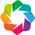

In [3]:
# data
import json
import pandas as pd
import numpy as np
import xarray as xr

# custom functions from the icenet repo
from utils import IceNetDataLoader, create_results_dataset_index, arr_to_ice_edge_arr

# modelling
from tensorflow.keras.models import load_model

# plotting
import matplotlib.pyplot as plt
from matplotlib.figure import Figure
from matplotlib.backends.backend_agg import FigureCanvas
from matplotlib.offsetbox import AnchoredText

import holoviews as hv

import hvplot.pandas
import hvplot.xarray

from bokeh.models.formatters import DatetimeTickFormatter

import panel as pn
pn.extension()

# utils
import urllib.request
import re
from tqdm.notebook import tqdm
import calendar
from pprint import pprint

pd.options.display.max_columns = 10
hv.extension('bokeh', width=100)

#### Set project structure

This cell uses three flags (`download_data`, `download_model`, `download_output`) for the user to indicate if they wish to load data, model and results from Gadi, or download them. By default, this project loads data from Gadi, and the flags are set to `False`. If the user wishes to download any of the data, results or model, you may set the respective flag below to `True`.  Following this, the project structure is setup. 

In [4]:
# Set the appropriate flag to True if you want to downlaod the data
download_data = False
download_model = False
download_output = False

# Set the respective locations for the data, models and output
data_folder = "/g/data/wb00/admin/staging/icenet/data/"
model_folder = "/g/data/wb00/admin/staging/icenet/model/"
outputs_folder = "/g/data/wb00/admin/staging/icenet/outputs/"

if download_data:
    data_folder = "./data"
    if not os.path.exists(data_folder):
        os.makedirs(data_folder)
        
if download_model:
    model_folder = "./model"
    if not os.path.exists(model_folder):
        os.makedirs(model_folder)
        
if download_output:
    outputs_folder = "./outputs"
    if not os.path.exists(outputs_folder):
        os.makedirs(outputs_folder)

# Set configuration paths
config = {
    'obs_data_folder': os.path.join(data_folder, 'ground_truth'),
    'mask_data_folder': os.path.join(data_folder, 'masks'),
    'forecast_data_folder': os.path.join(outputs_folder, 'forecasts'),
    'network_dataset_folder': os.path.join(data_folder, 'era5'),
    'dataloader_config_folder':  os.path.join(model_folder, 'configs'),
    'network_h5_files_folder': os.path.join(model_folder, 'pretrained'),
    'forecast_results_folder': os.path.join(outputs_folder, 'results'),
}

## 2. Load Data and Models

#### Download pretrained IceNet models

In [5]:
url = 'https://ramadda.data.bas.ac.uk/repository/entry/get/'
target_networks = [36, 42, 53]
for network in target_networks:
    if not os.path.exists ( os.path.join(config['network_h5_files_folder'],f'network_tempscaled_{network}.h5') ):
        urllib.request.urlretrieve(url + f'network_tempscaled_{network}.h5?entryid=synth%3A71820e7d-c628-4e32-969f-464b7efb187c%3AL25ldXJhbF9uZXR3b3JrX21vZGVsL25ldHdvcmtfdGVtcHNjYWxlZF8zNi5oNQ%3D%3D',
                               os.path.join(config['network_h5_files_folder'],f'network_tempscaled_{network}.h5'))
    else:
        print ("File exists:", os.path.join(config['network_h5_files_folder'],f'network_tempscaled_{network}.h5') )

File exists: /g/data/wb00/admin/staging/icenet/model/pretrained/network_tempscaled_36.h5
File exists: /g/data/wb00/admin/staging/icenet/model/pretrained/network_tempscaled_42.h5
File exists: /g/data/wb00/admin/staging/icenet/model/pretrained/network_tempscaled_53.h5


#### Check model files 

In [6]:
target_networks = [36, 42, 53]
for network in target_networks:
    val = os.path.join(config['network_h5_files_folder'],f'network_tempscaled_{network}.h5')
    if not os.path.exists(val):
        print ("Model file not found:", network)
    else:
        print ("File exists:", val )

File exists: /g/data/wb00/admin/staging/icenet/model/pretrained/network_tempscaled_36.h5
File exists: /g/data/wb00/admin/staging/icenet/model/pretrained/network_tempscaled_42.h5
File exists: /g/data/wb00/admin/staging/icenet/model/pretrained/network_tempscaled_53.h5


#### Download ERA5 data (climate observations)

In [7]:
filename = 'dataset1.zip'
url = f'https://zenodo.org/record/5516869/files/{filename}?download=1'

if not os.path.isfile(config['network_dataset_folder'] + '/dataset1.zip') or os.path.getsize(config['network_dataset_folder'] + '/dataset1.zip') == 0:
    urllib.request.urlretrieve(url, config['network_dataset_folder'] + '/dataset1.zip')
#    !cd /g/data/wb00/admin/staging/icenet_1 && unzip -qq ./data/network_datasets/dataset1.zip -d ./data/network_datasets
else:
    print ("Data File Exists:", config['network_dataset_folder'] + '/dataset1.zip')
    

Data File Exists: /g/data/wb00/admin/staging/icenet/data/era5/dataset1.zip


#### Download ground truth SIC

In [8]:
filename = 'siconca_EASE.nc'
url = f'https://zenodo.org/record/5516869/files/{filename}?download=1'

if not os.path.isfile(config['obs_data_folder'] + '/' + filename) or os.path.getsize(config['obs_data_folder'] + '/' + filename) == 0:
    urllib.request.urlretrieve(url, config['obs_data_folder'] + '/' + filename)
else:
    print ( "File Exists:", config['obs_data_folder'] + '/' + filename )

File Exists: /g/data/wb00/admin/staging/icenet/data/ground_truth/siconca_EASE.nc


#### Data loader

In [9]:
dataloader_ID = '2021_09_03_1300_icenet_demo.json'
url = f'https://zenodo.org/record/5516869/files/{dataloader_ID}?download=1'

if not os.path.isfile(config['dataloader_config_folder'] + '/' + dataloader_ID) or os.path.getsize(config['dataloader_config_folder'] + '/' + dataloader_ID) == 0:
    urllib.request.urlretrieve(url, config['dataloader_config_folder'] + '/' + dataloader_ID)
else:
    print ("File exists:", config['dataloader_config_folder'] + '/' + dataloader_ID)

print("Reading file "+config['dataloader_config_folder'] + '/' + dataloader_ID+"...")    
with open(config['dataloader_config_folder'] + '/' + dataloader_ID, 'r') as readfile:
    dataloader_config = json.load(readfile)
print("Printing data ...")   
pprint(dataloader_config['input_data'])

File exists: /g/data/wb00/admin/staging/icenet/model/configs/2021_09_03_1300_icenet_demo.json
Reading file /g/data/wb00/admin/staging/icenet/model/configs/2021_09_03_1300_icenet_demo.json...
Printing data ...
{'circmonth': {'include': True, 'metadata': True},
 'land': {'include': True, 'metadata': True},
 'psl': {'abs': {'include': False, 'max_lag': 3},
         'anom': {'include': True, 'max_lag': 3}},
 'rsds': {'abs': {'include': False, 'max_lag': 3},
          'anom': {'include': True, 'max_lag': 3}},
 'rsus': {'abs': {'include': False, 'max_lag': 3},
          'anom': {'include': True, 'max_lag': 3}},
 'siconca': {'abs': {'include': True, 'max_lag': 12},
             'anom': {'include': False, 'max_lag': 3},
             'linear_trend': {'include': True}},
 'ta500': {'abs': {'include': False, 'max_lag': 3},
           'anom': {'include': True, 'max_lag': 3}},
 'tas': {'abs': {'include': False, 'max_lag': 3},
         'anom': {'include': True, 'max_lag': 3}},
 'tos': {'abs': {'inclu

In [10]:
# Load dataloader
dataloader_config_fpath = os.path.join(config['dataloader_config_folder'], dataloader_ID)
print(dataloader_config_fpath)
# Data loader
print("\nSetting up the data loader with config file: {}\n\n".format(dataloader_ID))
dataloader = IceNetDataLoader(dataloader_config_fpath)
print('\n\nDone.\n')

/g/data/wb00/admin/staging/icenet/model/configs/2021_09_03_1300_icenet_demo.json

Setting up the data loader with config file: 2021_09_03_1300_icenet_demo.json




/scratch/fp0/rxm900/icenet/icenet/./icenet/utils.py:727: FutureWarning: Argument `closed` is deprecated in favor of `inclusive`.
  self.obs_forecast_IDs = list(pd.date_range(
/scratch/fp0/rxm900/icenet/icenet/./icenet/utils.py:749: FutureWarning: Argument `closed` is deprecated in favor of `inclusive`.
  member_id_dates = list(pd.date_range(




Done.



#### Load networks

In [11]:
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
network_regex = re.compile('^network_tempscaled_([0-9]*).h5$')

network_fpaths = [os.path.join(config['network_h5_files_folder'], f) for f in
                      sorted(os.listdir(config['network_h5_files_folder'])) if network_regex.match(f)]

ensemble_seeds = [network_regex.match(f)[1] for f in
                  sorted(os.listdir(config['network_h5_files_folder'])) if network_regex.match(f)]

networks = []
for network_fpath in network_fpaths:
    print('Loading model from {} ... '.format(network_fpath), end='', flush=True)
    networks.append(load_model(network_fpath, compile=False))
    print('Done.')

Loading model from /g/data/wb00/admin/staging/icenet/model/pretrained/network_tempscaled_36.h5 ... 

2023-05-05 18:28:47.790607: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1613] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 30961 MB memory:  -> device: 0, name: Tesla V100-SXM2-32GB, pci bus id: 0000:3d:00.0, compute capability: 7.0


Done.
Loading model from /g/data/wb00/admin/staging/icenet/model/pretrained/network_tempscaled_42.h5 ... Done.
Loading model from /g/data/wb00/admin/staging/icenet/model/pretrained/network_tempscaled_53.h5 ... Done.


#### Load ground truth SIC

In [12]:
print('Loading ground truth SIC... ', end='', flush=True)
true_sic_fpath = os.path.join(config['obs_data_folder'], 'siconca_EASE.nc')
true_sic_da = xr.open_dataarray(true_sic_fpath)
print('Done.')

Loading ground truth SIC... Done.


## 3. Modelling

This section deals with generating the forcasts predictions for IceNet. Note, if you are using the data on Gadi, the following cells will not generate a new forecast file.

#### Forecast settings

In [13]:
model = 'IceNet'

forecast_start = pd.Timestamp('2020-01-01')
forecast_end = pd.Timestamp('2020-12-01')

n_forecast_months = dataloader.config['n_forecast_months']
print('\n# of forecast months: {}\n'.format(n_forecast_months))


# of forecast months: 6



#### Set up forecast folder

In [14]:
forecast_folder = os.path.join(config['forecast_data_folder'])

if download_data:
    if not os.path.exists(forecast_folder):
        os.makedirs(forecast_folder)

#### Set up forecast DataArray dictionary

In [15]:
# define list of lead times
leadtimes = np.arange(1, n_forecast_months+1)

# add ensemble to the list of models
ensemble_seeds_and_mean = ensemble_seeds.copy()
ensemble_seeds_and_mean.append('ensemble')

all_target_dates = pd.date_range(
    start=forecast_start,
    end=forecast_end,
    freq='MS'
)

all_start_dates = pd.date_range(
    start=forecast_start - pd.DateOffset(months=n_forecast_months-1),
    end=forecast_end,
    freq='MS'
)

shape = (len(all_target_dates),
         *dataloader.config['raw_data_shape'],
         n_forecast_months)

coords = {
    'time': all_target_dates,  # To be sliced to target dates
    'yc': true_sic_da.coords['yc'],
    'xc': true_sic_da.coords['xc'],
    'lon': true_sic_da.isel(time=0).coords['lon'],
    'lat': true_sic_da.isel(time=0).coords['lat'],
    'leadtime': leadtimes,
    'seed': ensemble_seeds_and_mean,
    'ice_class': ['no_ice', 'marginal_ice', 'full_ice']
}

# Probabilistic SIC class forecasts
dims = ('seed', 'time', 'yc', 'xc', 'leadtime', 'ice_class')
shape = (len(ensemble_seeds_and_mean), *shape, 3)

model_forecast = xr.DataArray(
    data=np.zeros(shape, dtype=np.float32),
    coords=coords,
    dims=dims
)

#### Build up forecasts

In [16]:
if download_output:
    os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
    for start_date in tqdm(all_start_dates):

        # Target forecast dates for the forecast beginning at this `start_date`
        target_dates = pd.date_range(
            start=start_date,
            end=start_date + pd.DateOffset(months=n_forecast_months-1),
            freq='MS'
        )

        X, y, sample_weights = dataloader.data_generation([start_date])
        mask = sample_weights > 0
        pred = np.array([network.predict(X)[0] for network in networks])
        pred *= mask  # mask outside active grid cell region to zero
        # concat ensemble mean to the set of network predictions
        ensemble_mean_pred = pred.mean(axis=0, keepdims=True)
        pred = np.concatenate([pred, ensemble_mean_pred], axis=0)

        for i, (target_date, leadtime) in enumerate(zip(target_dates, leadtimes)):
            if target_date in all_target_dates:
                    model_forecast.\
                        loc[:, target_date, :, :, leadtime] = pred[..., i]

    print('Saving forecast NetCDF for {}... '.format(model), end='', flush=True)

    forecast_fpath = os.path.join(forecast_folder, f'{model.lower()}_forecasts.nc'.format(model.lower()))
    model_forecast.to_netcdf(forecast_fpath) #export file as Net

    print('Done.')

<a id='results'></a>
## 4. Results
This section deals with setting up the results settings and directories.

#### Setup

In [17]:
metric_compute_list = ['Binary accuracy', 'SIE error']

forecast_folder = os.path.join(config['forecast_data_folder'])
forecast_fpath = os.path.join(forecast_folder, f'{model.lower()}_forecasts.nc'.format(model.lower()))

chunks = {'seed': 1}
icenet_forecast_da = xr.open_dataarray(forecast_fpath, chunks=chunks)
icenet_seeds = icenet_forecast_da.seed.values

#### Monthly masks (active grid cell regions to compute metrics over)

In [18]:
mask_fpath_format = os.path.join(config['mask_data_folder'], 'active_grid_cell_mask_{}.npy')

month_mask_da = xr.DataArray(np.array(
    [np.load(mask_fpath_format.format('{:02d}'.format(month))) for
     month in np.arange(1, 12+1)],
))

#### Download previous results

In [19]:
url = 'https://ramadda.data.bas.ac.uk/repository/entry/get/'
fn = '2021_07_01_183913_forecast_results.csv'
fn_suffix = '?entryid=synth%3A71820e7d-c628-4e32-969f-464b7efb187c%3AL3Jlc3VsdHMvZm9yZWNhc3RfcmVzdWx0cy8yMDIxXzA3XzAxXzE4MzkxM19mb3JlY2FzdF9yZXN1bHRzLmNzdg%3D%3D'

if not os.path.isfile(os.path.join(config['forecast_results_folder'],fn)):
    urllib.request.urlretrieve(url + fn + fn_suffix, os.path.join(config['forecast_results_folder'],fn))
else: 
    print ("File exists:", os.path.join(config['forecast_results_folder'],fn))  

File exists: /g/data/wb00/admin/staging/icenet/outputs/results/2021_07_01_183913_forecast_results.csv


#### Initialise results dataframe

In [20]:
now = pd.Timestamp.now()
new_results_df_fname = now.strftime('%Y_%m_%d_%H%M%S_forecast_results.csv')
new_results_df_fpath = os.path.join('./', new_results_df_fname)

print('New results will be saved to {}\n\n'.format(new_results_df_fpath))

results_df_fnames = sorted([f for f in os.listdir(config['forecast_results_folder']) if re.compile('.*.csv').match(f)])
if len(results_df_fnames) >= 1:
    old_results_df_fname = results_df_fnames[-1]
    old_results_df_fpath = os.path.join(config['forecast_results_folder'], old_results_df_fname)
    print('\n\nLoading previous results dataset from {}'.format(old_results_df_fpath))

# Load previous results, do not interpret 'NA' as NaN
results_df = pd.read_csv(old_results_df_fpath, keep_default_na=False, comment='#')

# Remove existing IceNet results
results_df = results_df[~results_df['Model'].str.startswith('IceNet')]

# Drop spurious index column if present
results_df = results_df.drop('Unnamed: 0', axis=1, errors='ignore')
results_df['Forecast date'] = [pd.Timestamp(date) for date in results_df['Forecast date']]

results_df = results_df.set_index(['Model', 'Ensemble member', 'Leadtime', 'Forecast date'])

# Add new models to the dataframe
multi_index = create_results_dataset_index([model], leadtimes, all_target_dates, model, icenet_seeds)
results_df = results_df.append(pd.DataFrame(index=multi_index)).sort_index()

New results will be saved to ./2023_05_05_182854_forecast_results.csv




Loading previous results dataset from /g/data/wb00/admin/staging/icenet/outputs/results/2021_07_01_183913_forecast_results.csv


/jobfs/82626676.gadi-pbs/ipykernel_68826/3494903891.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(pd.DataFrame(index=multi_index)).sort_index()


#### Compute IceNet SIC

In [21]:
icenet_sip_da = icenet_forecast_da.sel(ice_class=['marginal_ice', 'full_ice']).sum('ice_class')

#### Ground truth SIC

In [22]:
true_sic_fpath = os.path.join(config['obs_data_folder'], 'siconca_EASE.nc')
true_sic_da = xr.open_dataarray(true_sic_fpath, chunks={})
true_sic_da = true_sic_da.load()
true_sic_da = true_sic_da.sel(time=all_target_dates)

if 'Binary accuracy' in metric_compute_list:
    binary_true_da = true_sic_da > 0.15

#### Monthwise masks

In [23]:
months = [pd.Timestamp(date).month - 1 for date in all_target_dates]
mask_da = xr.DataArray(
    [month_mask_da[month] for month in months],
    dims=('time', 'yc', 'xc'),
    coords={
        'time': true_sic_da.time.values,
        'yc': true_sic_da.yc.values,
        'xc': true_sic_da.xc.values,
    }
)

#### Compute performance metrics

In [24]:
print('Analysing forecasts: \n\n')

print('Computing metrics:')
print(metric_compute_list)

binary_forecast_da = icenet_sip_da > 0.5

compute_ds = xr.Dataset()
for metric in metric_compute_list:

    if metric == 'Binary accuracy':
        binary_correct_da = (binary_forecast_da == binary_true_da).astype(np.float32)
        binary_correct_weighted_da = binary_correct_da.weighted(mask_da)

        # Mean percentage of correct classifications over the active
        #   grid cell area
        ds_binacc = (binary_correct_weighted_da.mean(dim=['yc', 'xc']) * 100)
        compute_ds[metric] = ds_binacc

    elif metric == 'SIE error':
        binary_forecast_weighted_da = binary_forecast_da.astype(int).weighted(mask_da)
        binary_true_weighted_da = binary_true_da.astype(int).weighted(mask_da)

        ds_sie_error = (
            binary_forecast_weighted_da.sum(['xc', 'yc']) -
            binary_true_weighted_da.sum(['xc', 'yc'])
        ) * 25**2

        compute_ds[metric] = ds_sie_error

print('Writing to results dataset...')
for compute_da in iter(compute_ds.data_vars.values()):
    metric = compute_da.name

    compute_df_index = results_df.loc[
        pd.IndexSlice[model, :, leadtimes, all_target_dates], metric].\
        droplevel(0).index

    # Ensure indexes are aligned for assigning to results_df
    compute_df = compute_da.to_dataframe().reset_index().\
        set_index(['seed', 'leadtime', 'time']).\
        reindex(index=compute_df_index)

    results_df.loc[pd.IndexSlice[model, :, leadtimes, all_target_dates], metric] = \
        compute_df.values

print('\nCheckpointing results dataset... ', end='', flush=True)
results_df.to_csv(new_results_df_fpath)
print('Done.')

Analysing forecasts: 


Computing metrics:
['Binary accuracy', 'SIE error']
Writing to results dataset...

Checkpointing results dataset... Done.


<a id='analysis'></a>
## 4. Analysis
This section deals with visualizing and analyzing the prediction results

#### Plot settings

In [25]:
settings_lineplots = dict(padding=0.1, height=500, width=800, fontsize={'title': '120%','labels': '120%', 'ticks': '100%'})

#### Preprocess results dataset
We preprocess the results dataset generated above to prepare it for visualization. The dataset contains the leadtime and its corresponding forecast dates, months, the SIE error and the binary accuracy. 

In [26]:
# Reset index to preprocess results dataset
results_df = results_df.reset_index()

results_df['Forecast date'] = pd.to_datetime(results_df['Forecast date'])

month_names = np.array(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                        'Jul', 'Aug', 'Sept', 'Oct', 'Nov', 'Dec'])
forecast_month_names = month_names[results_df['Forecast date'].dt.month.values - 1]
results_df['Calendar month'] = forecast_month_names

results_df = results_df.set_index(['Model', 'Ensemble member', 'Leadtime', 'Forecast date'])

# subset target period
results_df = results_df.loc(axis=0)[pd.IndexSlice[:, :, :, slice(forecast_start, forecast_end)]]

results_df = results_df.sort_index()

In [27]:
results_df.head()

Binary accuracy  SIE error  \
Model  Ensemble member Leadtime Forecast date                               
IceNet 36              1        2020-01-01           95.697038  -457500.0   
                                2020-02-01           97.435745  -180000.0   
                                2020-03-01           97.507057  -215625.0   
                                2020-04-01           96.977625   -39375.0   
                                2020-05-01           97.439646   -13750.0   

                                              Calendar month  
Model  Ensemble member Leadtime Forecast date                 
IceNet 36              1        2020-01-01               Jan  
                                2020-02-01               Feb  
                                2020-03-01               Mar  
                                2020-04-01               Apr  
                                2020-05-01               May

#### Ice edge

After running the following two cells, Forecasts will be shown for the year of 2020. The lead time may be adjusted using the slider provided. The observed ice edge (in black) is defined as the sea ice concentration (SIC) = 15% contour. IceNet’s predicted ice edge (in green) is determined from its sea ice probability forecast as the P(SIC > 15%) = 0.5 contour. The binary classification accuracy and sea ice extent (SIE) error is shown for each forecast.

In [28]:
# set target year 
year = 2020

# set sliders
month_name = [f'{calendar.month_name[m]} {year}' for m in list(range(1, 13))]

month_slider = pn.widgets.DiscreteSlider(name="Month", options=month_name, value='September 2020', width=200)

lead_slider = pn.widgets.IntSlider(name="Lead time (months)", start=1, end=4, step=1, value=4, direction='rtl', width=200)


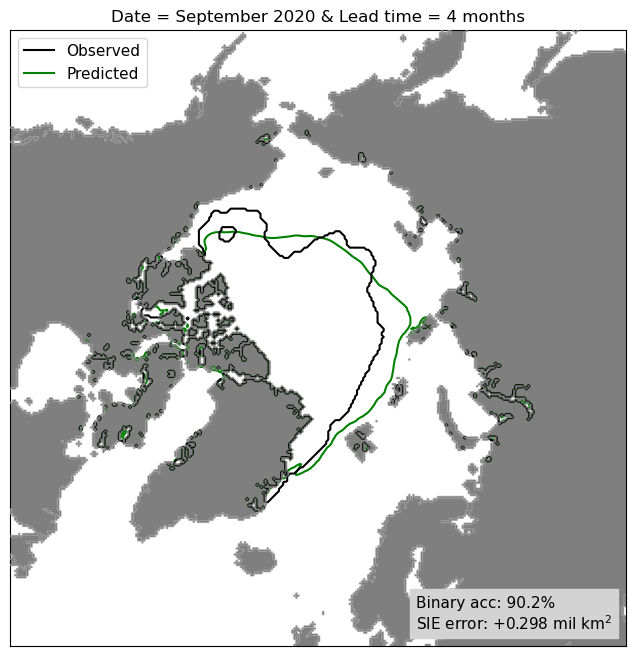
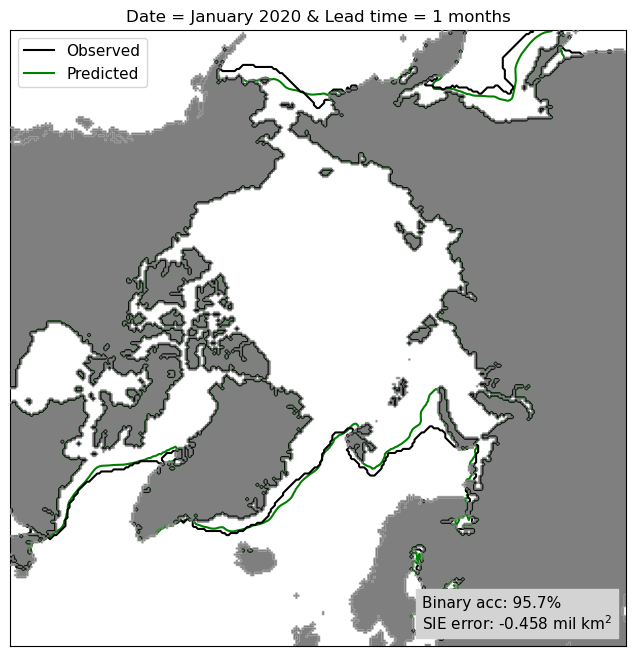
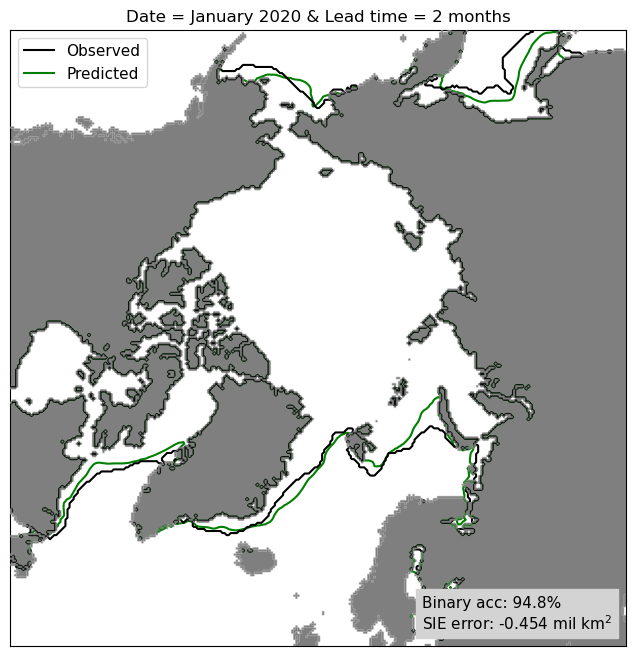
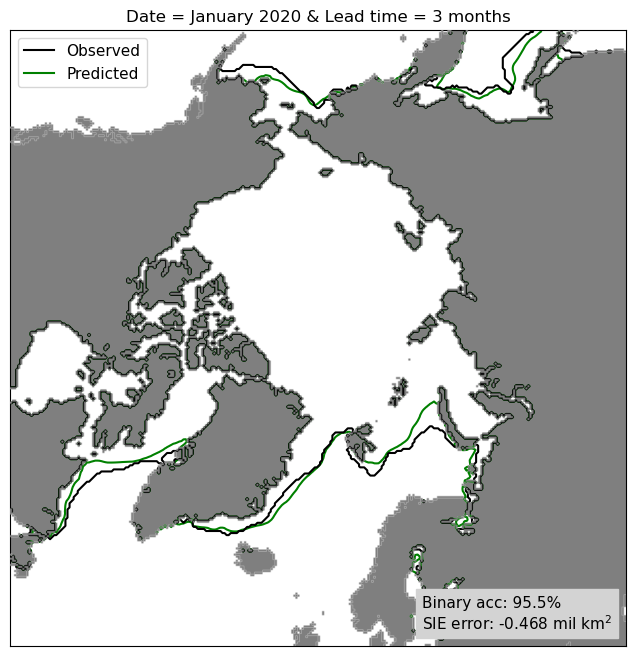
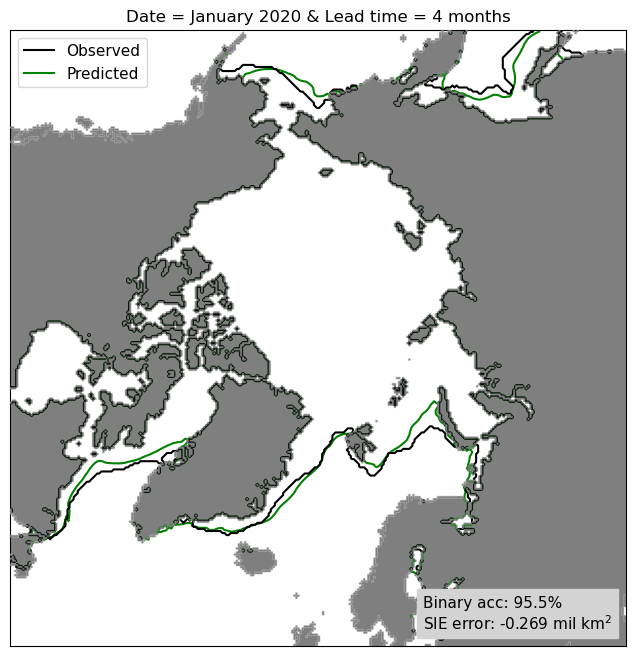
...
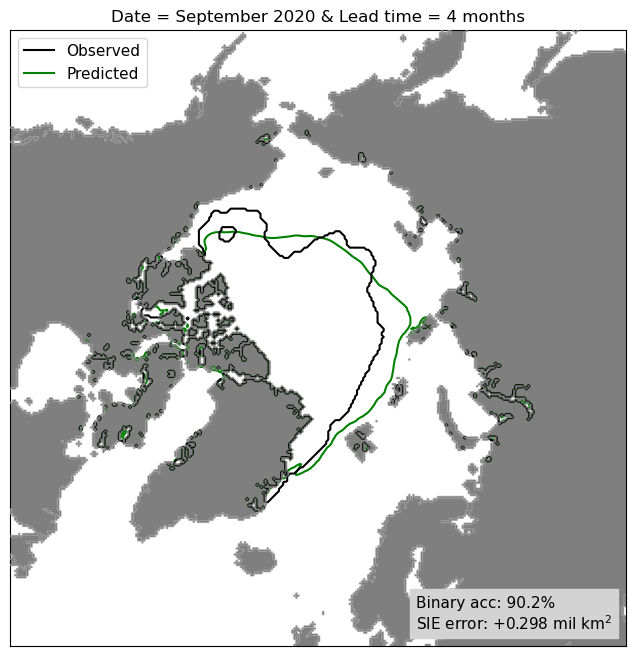
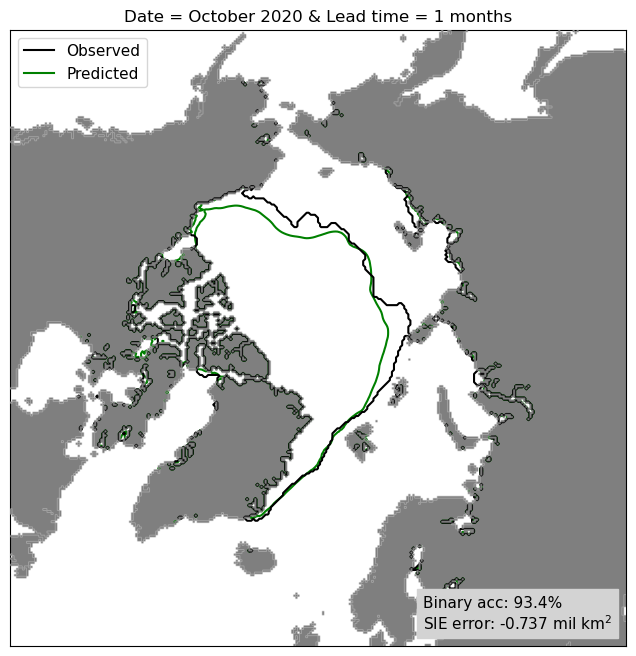
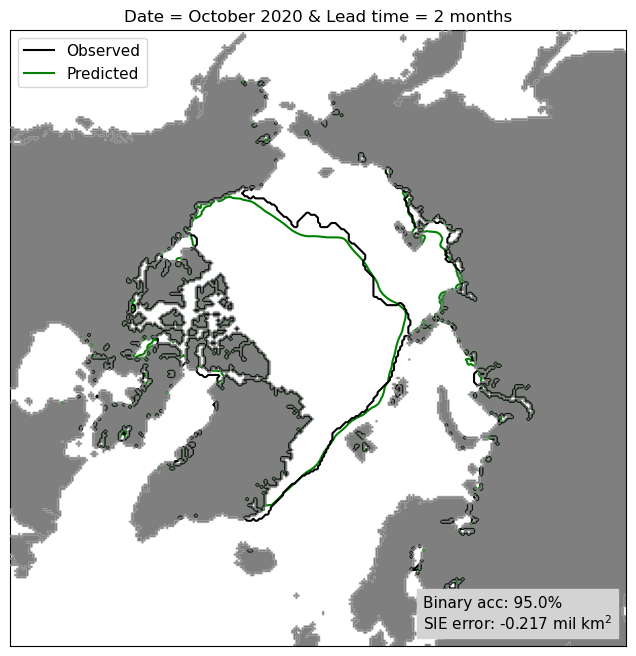
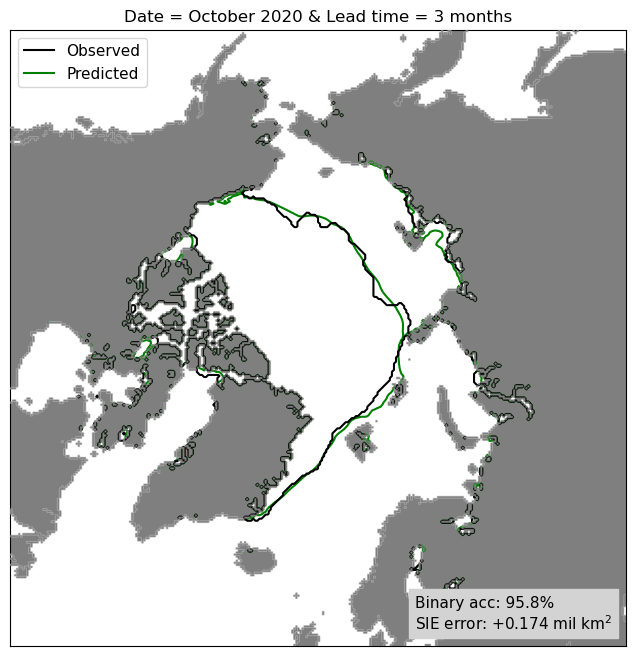
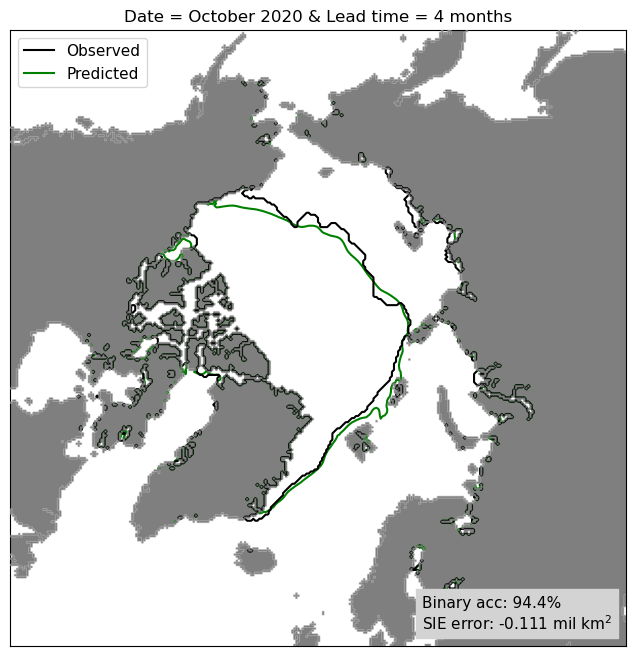

In [29]:
## set boundaries
mask = np.load(os.path.join(config['mask_data_folder'],
                            'active_grid_cell_mask_{}.npy'.format('03')))

min_0 = np.min(np.argwhere(mask)[:, 0])
max_0 = np.max(np.argwhere(mask)[:, 0])
mid_0 = np.mean((min_0, max_0)).astype(int)
min_1 = np.min(np.argwhere(mask)[:, 1])
max_1 = np.max(np.argwhere(mask)[:, 1])
mid_1 = np.mean((min_1, max_1)).astype(int)
max_diff = np.max([mid_0-min_0, mid_1-min_1])
max_diff *= .85  # Zoom in
max_diff = int(max_diff)
top = mid_0 - max_diff + 10
bot = mid_0 + max_diff + 10
left = mid_1 - max_diff
right = mid_1 + max_diff

## land and region masks
land_mask = np.load(os.path.join(config['mask_data_folder'], 'land_mask.npy'))
region_mask = np.load(os.path.join(config['mask_data_folder'], 'region_mask.npy'))

## define coastline and land layers
arr = region_mask == 13
coastline_rgba_arr = np.zeros((*arr.shape, 4))
coastline_rgba_arr[:, :, 3] = arr  # alpha channel
coastline_rgba_arr[:, :, :3] = .5  # black coastline
land_mask_rgba_arr = np.zeros((*arr.shape, 4))
land_mask_rgba_arr[:, :, 3] = land_mask  # alpha channel
land_mask_rgba_arr[:, :, :3] = .5  # gray land

## line colours
pred_ice_edge_rgb = 'green'
true_ice_edge_rgb = 'black'

## define plot function
@pn.depends(month_slider.param.value, lead_slider.param.value)
def plot_forecast(month, leadtime):
    tdate = pd.Timestamp(year,month_name.index(month)+1,1)

    fig0 = Figure(figsize=(8, 8))
    ax0 = fig0.subplots()
    FigureCanvas(fig0)  # not needed for mpl >= 3.1

    ax0.imshow(coastline_rgba_arr[top:bot, left:right, :], zorder=20)
    ax0.imshow(land_mask_rgba_arr[top:bot, left:right, :], zorder=1)

    icenet_sip = icenet_sip_da.sel(time=tdate, leadtime=leadtime, seed='ensemble').data
    ax0.contour(
        icenet_sip[top:bot, left:right],
        levels=[0.5],
        colors=[pred_ice_edge_rgb],
        zorder=1,
        linewidths=1.5,
    )

    groundtruth_sic = true_sic_da.sel(time=tdate)
    gt_img = (groundtruth_sic>0.15).data

    ax0.contour(
        gt_img[top:bot, left:right],
        levels=[0.5],
        colors=[true_ice_edge_rgb],
        zorder=1,
        linewidths=1.5
    )
    ax0.tick_params(which='both', bottom=False, left=False, labelbottom=False, labelleft=False)

    proxy = [plt.Line2D([0], [1], color=true_ice_edge_rgb),
                         plt.Line2D([0], [1], color=pred_ice_edge_rgb)]

    ax0.legend(proxy, ['Observed', 'Predicted'],
                          loc='upper left', fontsize=11)

    ax0.set_title(f'Date = {month} & Lead time = {leadtime} months')

    acc = results_df.loc['IceNet', 'ensemble', leadtime, tdate]['Binary accuracy']
    sie_err = results_df.loc['IceNet', 'ensemble', leadtime, tdate]['SIE error']

    Afont = {
        'backgroundcolor': 'lightgray',
        'color':  'black',
        'weight': 'normal',
        'size': 11,
        }

    t = AnchoredText('Binary acc: {:.1f}% \nSIE error: {:+.3f} mil km$^2$'.format(acc,sie_err/1e6), prop=Afont, loc='lower right', pad=0.5, borderpad=0.4, frameon=False)
    t = ax0.add_artist(t)
    t.zorder = 21

    return pn.pane.Matplotlib(fig0, tight=True, dpi=150)

plot_ie = pn.Row(
    plot_forecast,
    pn.Column(pn.Spacer(height=5), month_slider, pn.Spacer(height=15), lead_slider, background='#ADD8E6', sizing_mode="fixed"),
    width_policy='max', height_policy='max', 
)

plot_ie.embed()

#### Model performance comparison
Running the following cell generates a comparison of the mean binary accuracy vs lead time for IceNet compared against SEAS5 and the linear trend model.

In [30]:
results_mean = results_df['Binary accuracy'].groupby(['Model','Ensemble member','Leadtime']).mean().reset_index()
results_mean = results_mean[results_mean['Ensemble member'].isin(['NA','ensemble'])]

plot_ba = results_mean.hvplot(x='Leadtime', y='Binary accuracy', by='Model',
                        label='Lead times comparison',
                        ylabel='Binary accuracy',
                        xlabel='Lead time (months)',
                        color=['#1f77b4', 'gray', '#d62728'])
plot_ba.opts(legend_position='top', **settings_lineplots)
plot_ba

:NdOverlay   [Model]
   :Curve   [Leadtime]   (Binary accuracy)

#### Monthly performance comparison
Running the following cell generates a monthly comparison of the mean binary accuracy vs forecast date for IceNet compared against SEAS5 and the linear trend model.

In [31]:
lead_slider = pn.widgets.IntSlider(name="Lead time (months)", start=1, end=4, step=1, width=150)

results_plot = results_df.reset_index()

formatter = DatetimeTickFormatter(months='%b')

@pn.depends(lead_slider.param.value)
def plot_month(leadtime):

    results_lt = results_plot[results_plot.Leadtime==leadtime]
    plot_ba = results_lt.hvplot(x='Forecast date',
                                y='Binary accuracy',
                                by='Model',
                                label='Monthly comparison',
                                ylabel='Binary accuracy',
                                xlabel='Forecast month',
                                color=['#1f77b4', 'gray', '#d62728'],
                                xformatter=formatter)

    return plot_ba.opts(legend_position='top', **settings_lineplots)

plot_month = pn.Row(
    plot_month,
    pn.Column(pn.Spacer(height=5), lead_slider, background='#ADD8E6'),
    width_policy='max', height_policy='max',
)

plot_month.embed()